In [1]:
import sys
sys.path.append("../")

from torch import nn
from models import DisenrangledNetwork, get_simple_classifier, ProjectorNetwork

import torch
from torch.nn import functional as F
import numpy as np
from data_utils import load_svhn
from matplotlib import pyplot as plt
from train import train_disentangle
from utils import plot_swapped_styles

In [2]:
torch.manual_seed(123)
import numpy as np
np.random.seed(123)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [3]:
class Decoder(nn.Module):
    def __init__(self, latent_space_dim, conv_feat_size, nb_channels=3):
        super(Decoder, self).__init__()

        self.latent_space_dim = latent_space_dim
        self.conv_feat_size = conv_feat_size

        self.deco_dense = nn.Sequential(
            nn.Linear(in_features=latent_space_dim, out_features=1024),
            nn.ReLU(True),
            nn.Linear(in_features=1024, out_features=np.prod(self.conv_feat_size)),
            nn.ReLU(True),
        )

        self.deco_fetures = nn.Sequential(
            nn.Conv2d(self.conv_feat_size[0], out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(True),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels=64, out_channels=32, kernel_size=5, padding=2),
            nn.ReLU(True),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels=32, out_channels=nb_channels, kernel_size=5, padding=2),
            nn.Sigmoid()
        )

    def forward(self, z_share, z_spe):
        z = torch.cat([z_share, z_spe], 1)
        feat_encode = self.deco_dense(z)
        feat_encode = feat_encode.view(-1, *self.conv_feat_size)
        y = self.deco_fetures(feat_encode)

        return y


class Encoder(nn.Module):
    def __init__(self, latent_space_dim, img_size, nb_channels=3):
        super(Encoder, self).__init__()

        self.latent_space_dim = latent_space_dim
        self.nb_channels = nb_channels

        self.conv_feat = nn.Sequential(
            nn.Conv2d(nb_channels, out_channels=32, kernel_size=5, padding=2),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5, padding=2),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(True),
        )

        self.conv_feat_size = self.conv_feat(torch.zeros(1, *img_size)).shape[1:]
        self.dense_feature_size = np.prod(self.conv_feat_size)

        self.dense_feat = nn.Linear(in_features=self.dense_feature_size, out_features=1024)
        self.share_feat = nn.Linear(in_features=1024, out_features=latent_space_dim)
        self.style_feat = nn.Linear(in_features=1024, out_features=latent_space_dim)


    def forward(self, input_data, mode='all'):
        if (input_data.shape[1] == 1) & (self.nb_channels == 3):
            input_data = input_data.repeat(1, 3, 1, 1)
        feat = self.conv_feat(input_data)
        feat = feat.view(-1, self.dense_feature_size)
        feat = F.relu(self.dense_feat(feat))
        
        if mode == 'all':
            z_share = F.relu(self.share_feat(feat))
            z_style = F.relu(self.style_feat(feat))
            return z_share, z_style
        
        elif mode == 'style':
            z_style = F.relu(self.style_feat(feat))
            return z_style

In [ ]:
import torch
import numpy as np
from torch import nn
from tqdm import tqdm
from utils import show_decoded_images


criterion_reconstruction = nn.BCELoss()
criterion_classifier = nn.NLLLoss(reduction='mean')
criterion_weighted_classifier = nn.NLLLoss(reduction='none')
criterion_disentangle = nn.MSELoss()
criterion_distance = nn.MSELoss()
criterion_triplet = nn.TripletMarginLoss(margin=1)

criterion_reconstruction = nn.BCELoss()
disentangle_criterion = nn.MSELoss()
criterion_classifier = nn.NLLLoss(reduction='mean')
criterion_triplet = nn.TripletMarginLoss(margin=1)


def train_disentangle(model, optimizer, random_projector, source_train_loader,
                      epochs=30, beta_max=10, running_beta=20, alpha_max=5, alpha_min=5, show_images=False):
    betas = np.zeros(epochs)
    betas[:running_beta] = np.linspace(0.01, beta_max, running_beta)
    betas[running_beta:] = np.ones(epochs - running_beta) * beta_max
    alpha = np.linspace(alpha_min, alpha_max, epochs)

    t = tqdm(range(epochs))
    for epoch in t:
        corrects, total = 0, 0
        # random images used for disentanglement
        for x, y in source_train_loader:
            loss = 0
            x = x.cuda()
            y = y.cuda()
            x_hat, y_hat, (z_task, z_style), (pred_task, pred_style) = model(x, mode='all')
            # random projections to reduce dimension
            random_task = random_projector(z_task)
            random_style = random_projector(z_style)
            z_style_r = model.encoder(torch.flip(x, [0]), mode='style')
            x_prime = model.decoder(z_task, z_style_r)
            y_tilde, z_style_tilde = model(x_prime, mode='style')

            loss += alpha[epoch] * criterion_reconstruction(x_hat, x)
            loss += criterion_classifier(y_hat, y)
            loss += betas[epoch] * (disentangle_criterion(pred_task, random_task) + disentangle_criterion(pred_style, random_style))
            loss += 0.1 * criterion_classifier(y_tilde, y)
            loss += 0.1 * criterion_triplet(z_style_tilde, z_style_r, z_style)
            
            _, predicted = y_hat.max(1)
            corrects += predicted.eq(y).sum().item()
            total += y.size(0)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            t.set_description(f'epoch:{epoch} current accuracy:{round(corrects / total * 100, 2)}%')
        # ===================log========================
        if show_images:
            show_decoded_images(x[:32], x_hat[:32], torch.flip(x, [0])[:32], x_prime[:32])

In [4]:
source_train_loader, source_test_loader = load_svhn(img_size=(32, 32), batch_size=128, split=1, shuffle=True, num_workers=8)

Using downloaded and verified file: ../data/train_32x32.mat


epoch:0 current accuracy:18.46%:   0%|          | 0/50 [00:24<?, ?it/s]

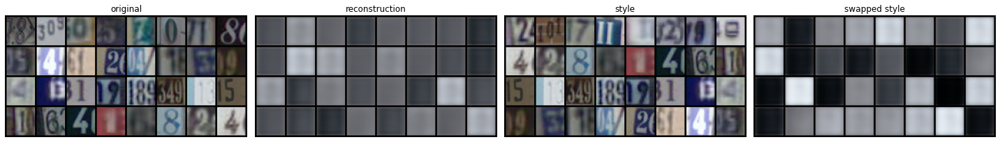

epoch:1 current accuracy:18.87%:   2%|▏         | 1/50 [00:49<20:16, 24.83s/it]

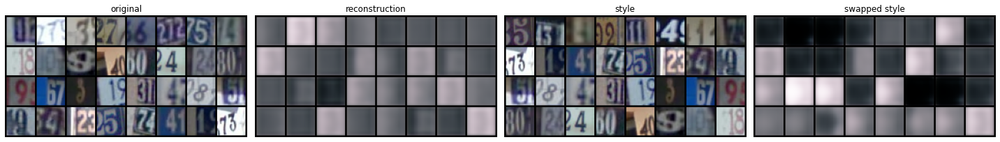

epoch:2 current accuracy:18.84%:   4%|▍         | 2/50 [01:14<19:51, 24.82s/it]

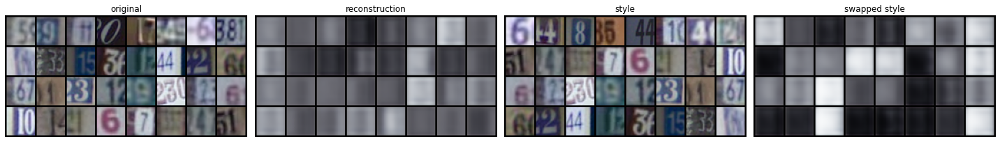

epoch:3 current accuracy:25.26%:   6%|▌         | 3/50 [01:38<19:26, 24.83s/it]

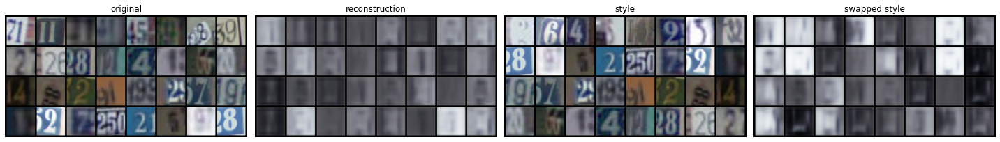

epoch:4 current accuracy:57.51%:   8%|▊         | 4/50 [02:03<19:02, 24.84s/it]

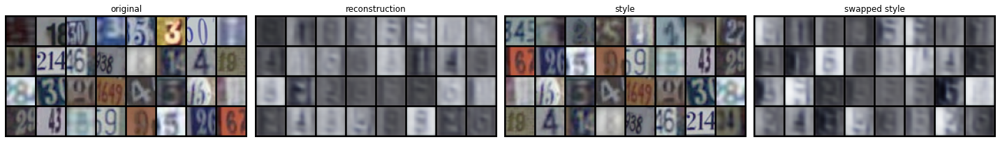

epoch:5 current accuracy:77.66%:  10%|█         | 5/50 [02:28<18:38, 24.86s/it]

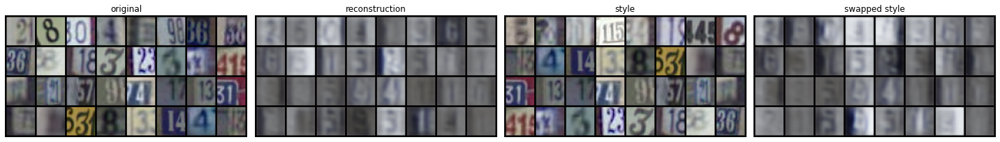

epoch:6 current accuracy:83.72%:  12%|█▏        | 6/50 [02:53<18:17, 24.95s/it]

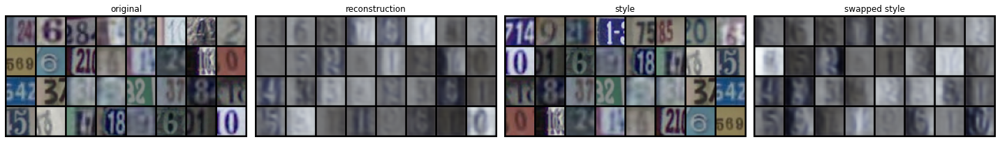

epoch:7 current accuracy:86.71%:  14%|█▍        | 7/50 [03:18<17:52, 24.93s/it]

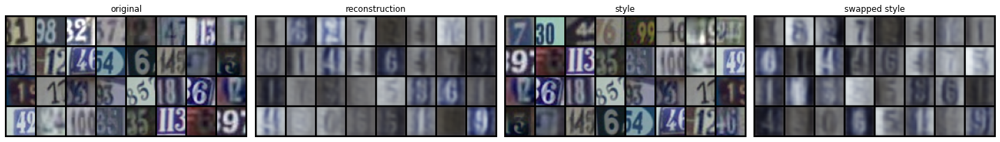

epoch:8 current accuracy:88.51%:  16%|█▌        | 8/50 [03:43<17:27, 24.93s/it]

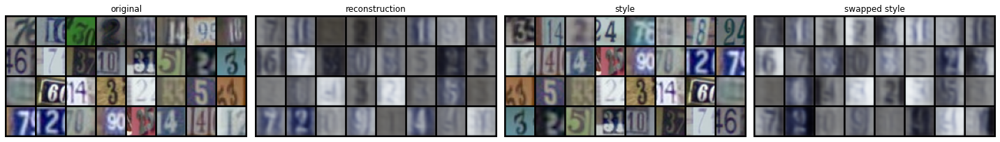

epoch:9 current accuracy:89.5%:  18%|█▊        | 9/50 [04:08<17:01, 24.92s/it] 

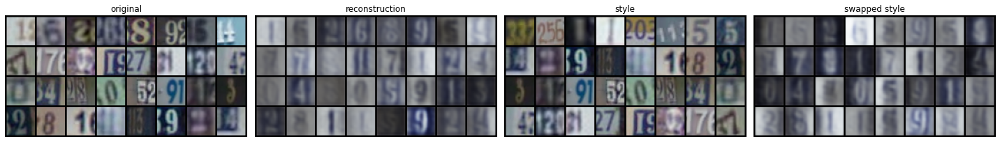

epoch:10 current accuracy:90.47%:  20%|██        | 10/50 [04:33<16:37, 24.93s/it]

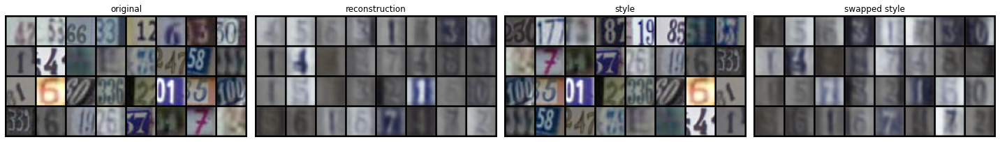

epoch:11 current accuracy:91.18%:  22%|██▏       | 11/50 [04:58<16:12, 24.95s/it]

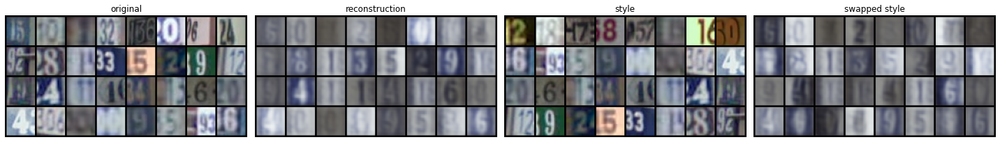

epoch:12 current accuracy:91.75%:  24%|██▍       | 12/50 [05:23<15:46, 24.92s/it]

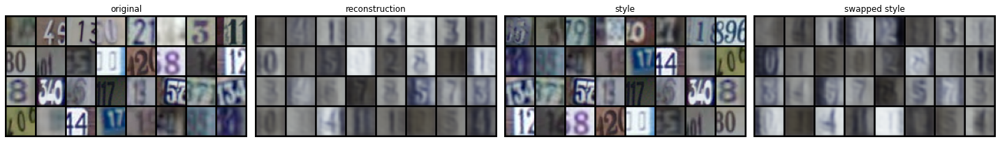

epoch:13 current accuracy:92.36%:  26%|██▌       | 13/50 [05:48<15:21, 24.91s/it]

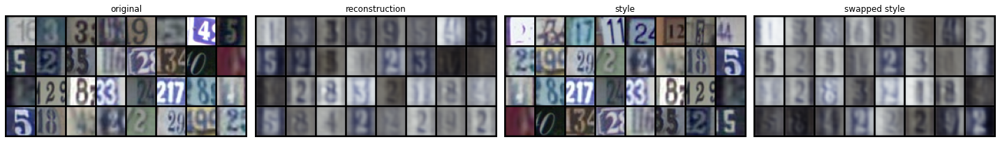

epoch:14 current accuracy:92.83%:  28%|██▊       | 14/50 [06:13<14:56, 24.90s/it]

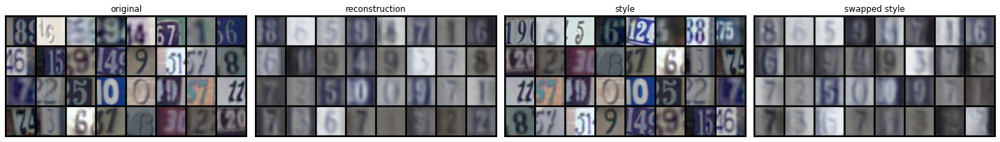

epoch:15 current accuracy:93.33%:  30%|███       | 15/50 [06:37<14:31, 24.90s/it]

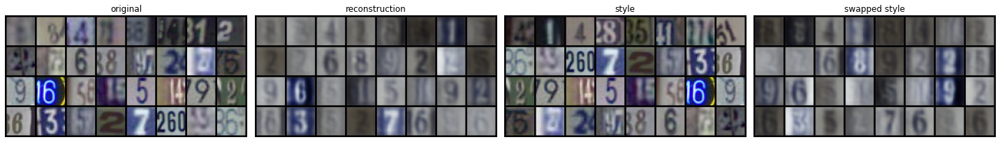

epoch:16 current accuracy:93.77%:  32%|███▏      | 16/50 [07:03<14:05, 24.88s/it]

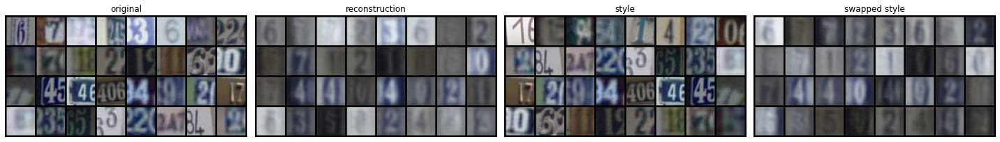

epoch:17 current accuracy:94.17%:  34%|███▍      | 17/50 [07:27<13:43, 24.96s/it]

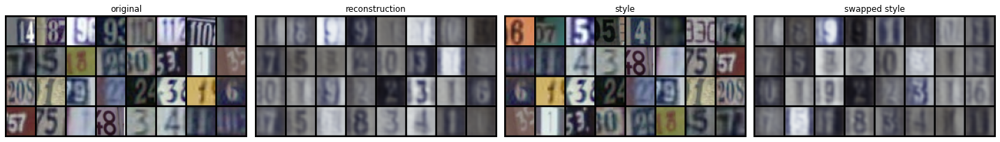

epoch:18 current accuracy:94.49%:  36%|███▌      | 18/50 [07:52<13:17, 24.94s/it]

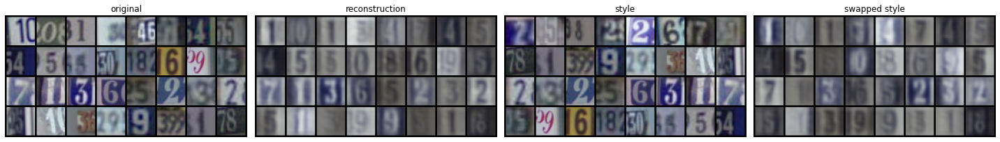

epoch:19 current accuracy:94.64%:  38%|███▊      | 19/50 [08:17<12:52, 24.91s/it]

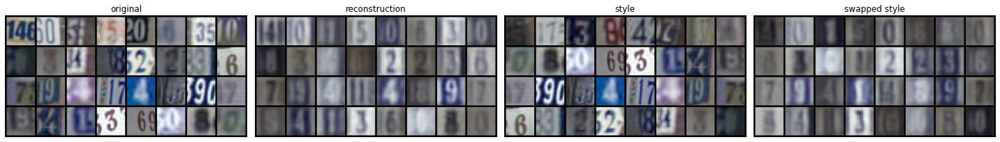

epoch:20 current accuracy:94.94%:  40%|████      | 20/50 [08:42<12:27, 24.90s/it]

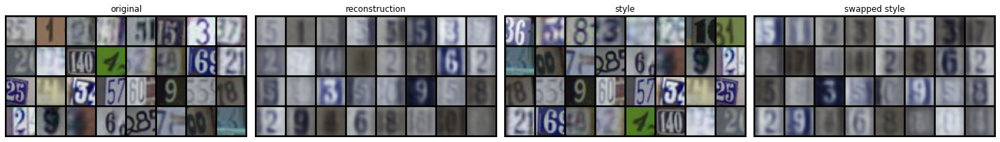

epoch:21 current accuracy:95.09%:  42%|████▏     | 21/50 [09:07<12:01, 24.88s/it]

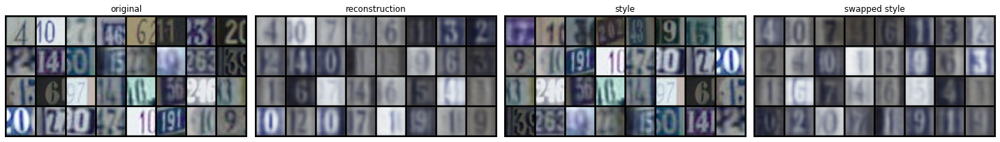

epoch:22 current accuracy:95.55%:  44%|████▍     | 22/50 [09:32<11:37, 24.90s/it]

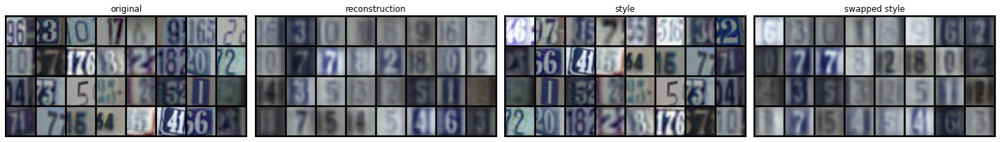

epoch:23 current accuracy:95.59%:  46%|████▌     | 23/50 [09:57<11:11, 24.89s/it]

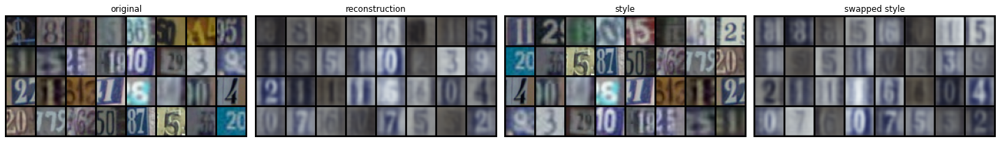

epoch:24 current accuracy:95.77%:  48%|████▊     | 24/50 [10:22<10:47, 24.89s/it]

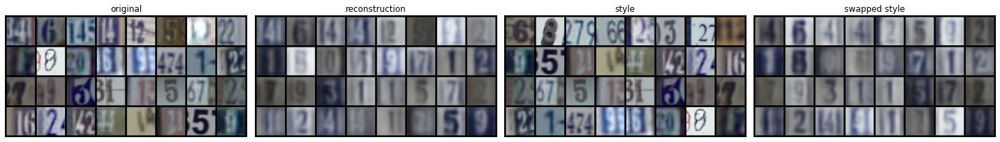

epoch:25 current accuracy:96.07%:  50%|█████     | 25/50 [10:46<10:22, 24.89s/it]

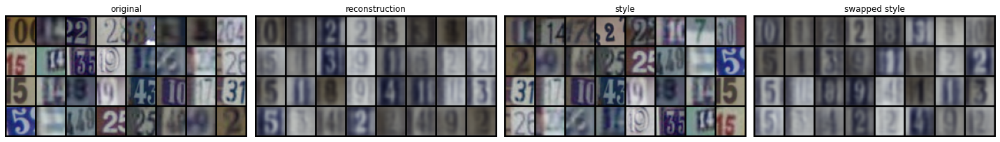

epoch:26 current accuracy:96.3%:  52%|█████▏    | 26/50 [11:11<09:57, 24.88s/it] 

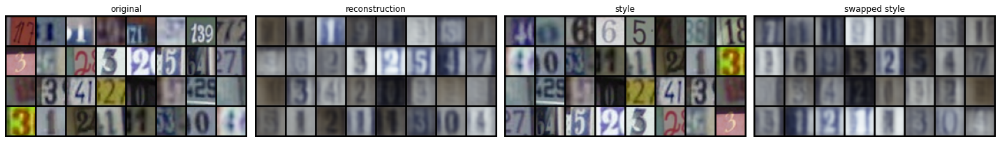

epoch:27 current accuracy:96.35%:  54%|█████▍    | 27/50 [11:36<09:32, 24.89s/it]

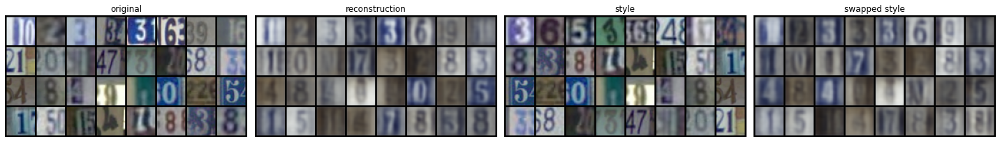

epoch:28 current accuracy:96.33%:  56%|█████▌    | 28/50 [12:01<09:08, 24.95s/it]

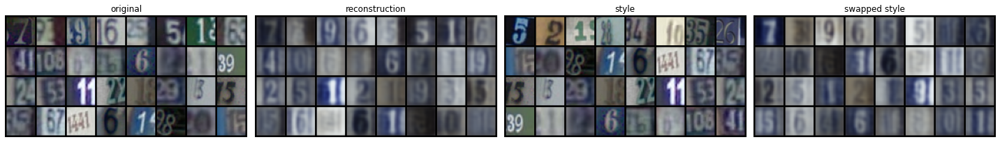

epoch:29 current accuracy:96.68%:  58%|█████▊    | 29/50 [12:26<08:42, 24.90s/it]

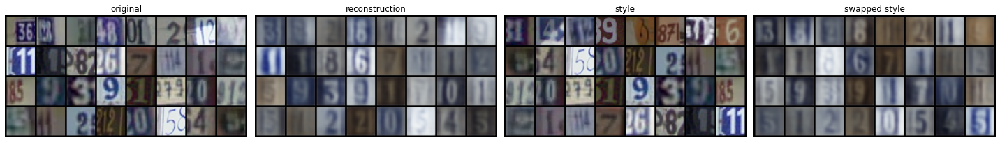

epoch:30 current accuracy:96.66%:  60%|██████    | 30/50 [12:51<08:17, 24.90s/it]

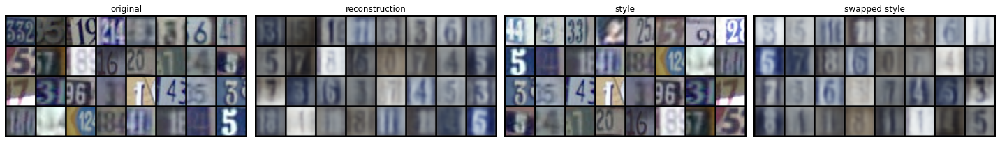

epoch:31 current accuracy:96.81%:  62%|██████▏   | 31/50 [13:16<07:53, 24.91s/it]

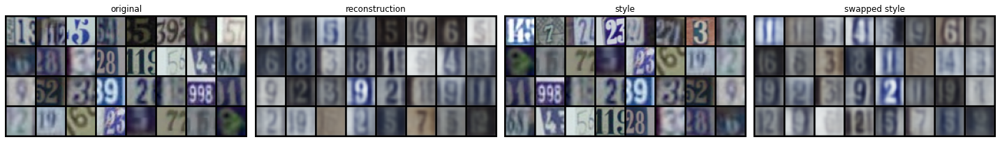

epoch:32 current accuracy:96.95%:  64%|██████▍   | 32/50 [13:41<07:28, 24.91s/it]

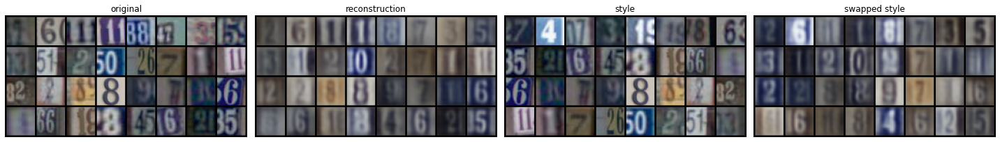

epoch:33 current accuracy:97.0%:  66%|██████▌   | 33/50 [14:06<07:04, 24.95s/it] 

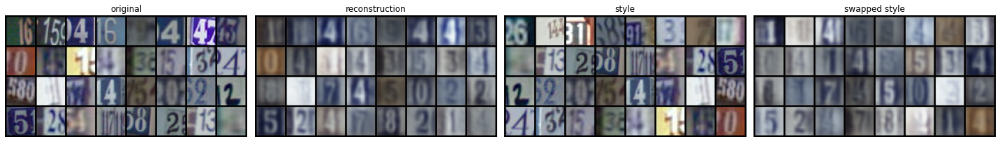

epoch:34 current accuracy:97.05%:  68%|██████▊   | 34/50 [14:31<06:39, 24.95s/it]

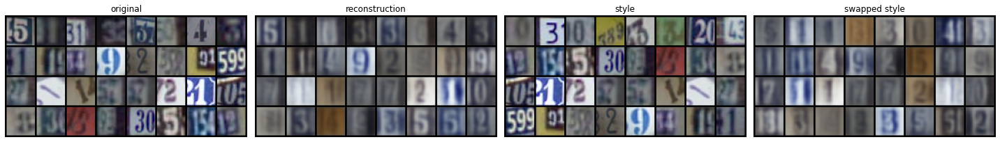

epoch:35 current accuracy:97.12%:  70%|███████   | 35/50 [14:56<06:13, 24.93s/it]

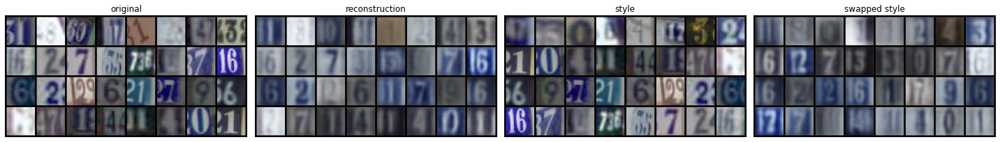

epoch:36 current accuracy:97.21%:  72%|███████▏  | 36/50 [15:21<05:49, 24.93s/it]

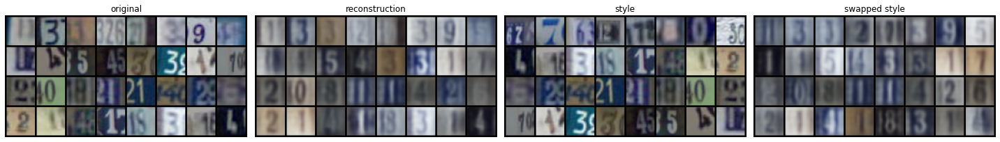

epoch:37 current accuracy:97.21%:  74%|███████▍  | 37/50 [15:46<05:24, 24.94s/it]

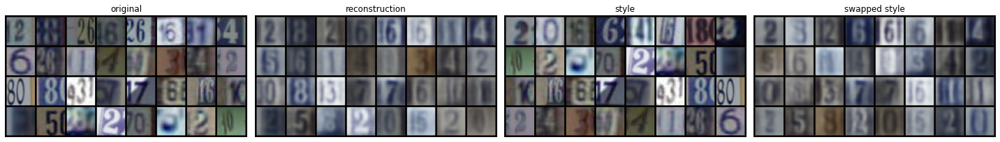

epoch:38 current accuracy:97.34%:  76%|███████▌  | 38/50 [16:11<04:59, 24.93s/it]

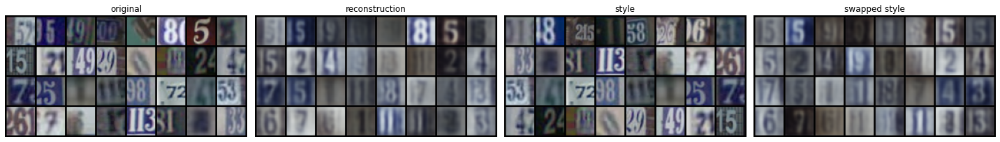

epoch:39 current accuracy:97.31%:  78%|███████▊  | 39/50 [16:36<04:35, 25.02s/it]

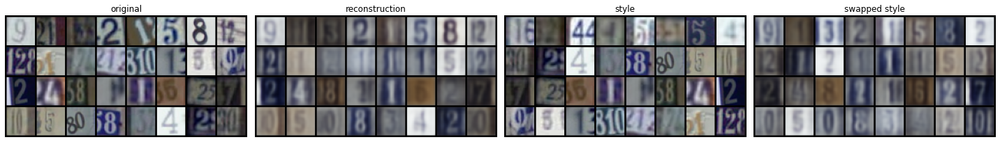

epoch:40 current accuracy:97.38%:  80%|████████  | 40/50 [17:01<04:09, 24.99s/it]

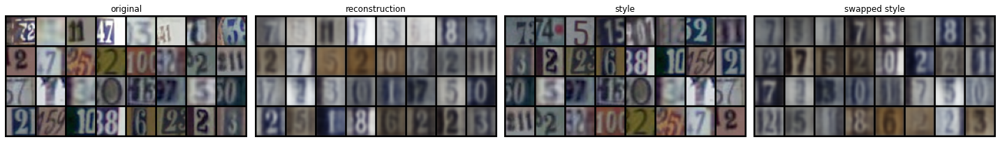

epoch:41 current accuracy:97.5%:  82%|████████▏ | 41/50 [17:26<03:44, 24.98s/it] 

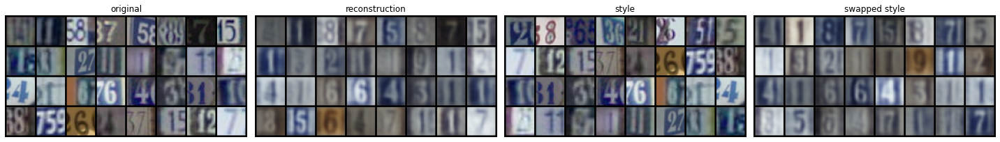

epoch:42 current accuracy:97.47%:  84%|████████▍ | 42/50 [17:51<03:19, 24.96s/it]

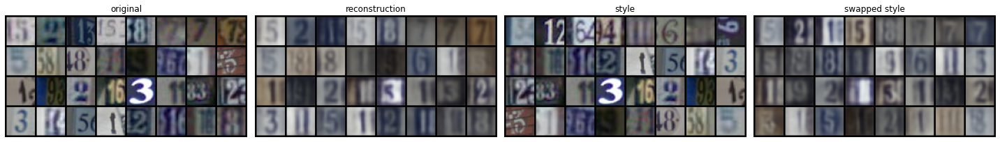

epoch:43 current accuracy:97.62%:  86%|████████▌ | 43/50 [18:16<02:54, 24.95s/it]

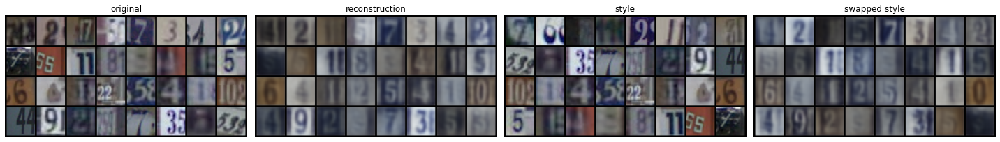

epoch:44 current accuracy:97.51%:  88%|████████▊ | 44/50 [18:41<02:29, 24.97s/it]

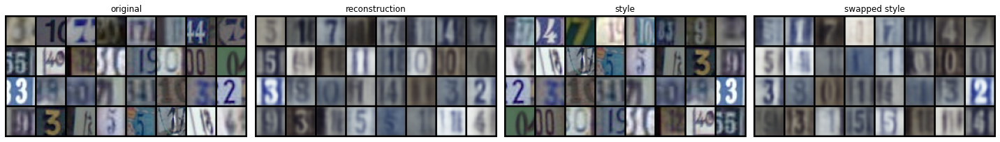

epoch:45 current accuracy:97.64%:  90%|█████████ | 45/50 [19:05<02:04, 24.95s/it]

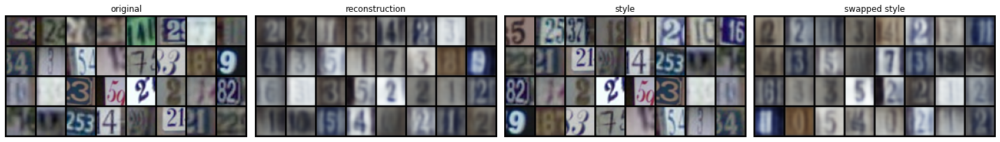

epoch:46 current accuracy:97.8%:  92%|█████████▏| 46/50 [19:30<01:39, 24.93s/it] 

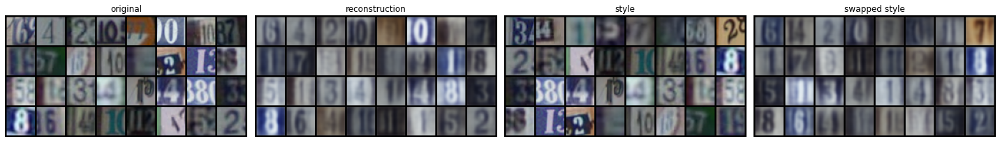

epoch:47 current accuracy:97.69%:  94%|█████████▍| 47/50 [19:55<01:14, 24.93s/it]

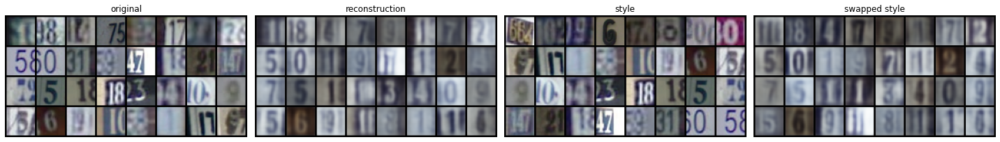

epoch:48 current accuracy:97.79%:  96%|█████████▌| 48/50 [20:20<00:49, 24.94s/it]

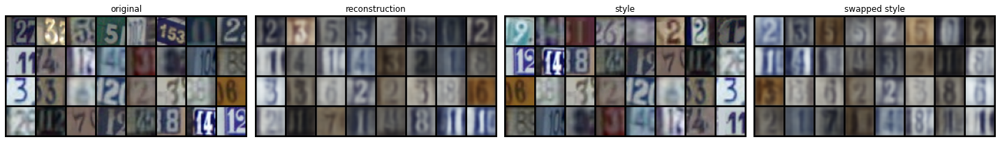

epoch:49 current accuracy:97.76%:  98%|█████████▊| 49/50 [20:45<00:24, 24.93s/it]

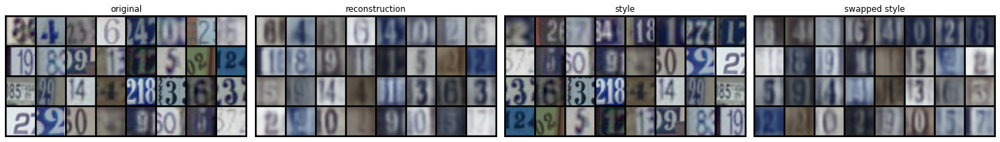

epoch:49 current accuracy:97.76%: 100%|██████████| 50/50 [20:46<00:00, 24.93s/it]


In [5]:
learning_rate = 5e-4

encoder = Encoder(latent_space_dim=150, img_size=(3,32,32), nb_channels=3)
conv_feat_size = encoder.conv_feat_size
decoder = Decoder(latent_space_dim=300, conv_feat_size=conv_feat_size, nb_channels=3)
classifier = get_simple_classifier(latent_space_dim=150)
model = DisenrangledNetwork(encoder, decoder, classifier).cuda()
random_projector = ProjectorNetwork(latent_dim=150).cuda()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.001)

train_disentangle(model, optimizer, random_projector, source_train_loader, epochs=50, beta_max=10, running_beta=10, show_images=True, alpha_min=5, alpha_max=10)

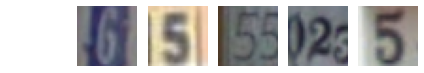

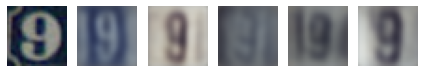

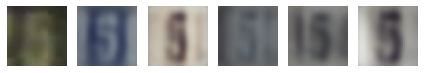

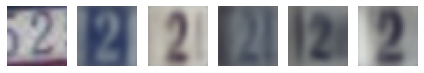

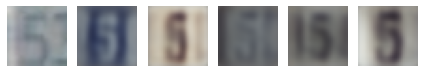

...

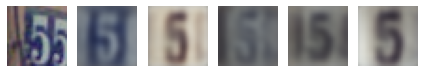

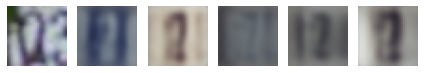

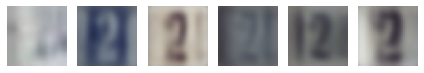

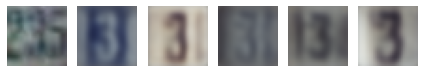

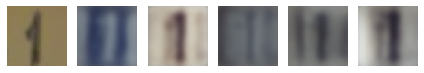

In [7]:
plot_swapped_styles(model, source_train_loader)

In [8]:
!pip3 install foolbox==3.1.1

     |████████████████████████████████| 1.7 MB 14.8 MB/s eta 0:00:01


In [9]:
import foolbox as fb

In [11]:
bounds = (0, 1)
fmodel = fb.PyTorchModel(model.eval(), bounds=bounds)

In [36]:
fmodel = fmodel.transform_bounds((0, 1))


In [27]:
import foolbox as fb

bounds = (0, 1)
fmodel = fb.PyTorchModel(model.eval(), bounds=bounds)
fmodel = fmodel.transform_bounds((0, 1))

images, labels = x, y =next(iter(source_train_loader))
images = images[:16]
labels = labels[:16]
images = images.cuda()
labels = labels.cuda()
class FModel(nn.Module):
    def __init__(self, model):
        super(FModel, self).__init__()

        self.model = model

    def forward(self, x):
        return self.model(x, mode='pred')
fmodel = FModel(model).cuda()

fmodel = fb.PyTorchModel(fmodel.eval(), bounds=bounds)
fmodel = fmodel.transform_bounds((0, 1))
fb.utils.accuracy(fmodel, images, labels)

attack = fb.attacks.LinfDeepFoolAttack()
advs, clipped, is_adv = attack(fmodel, images, labels, epsilons=0.03)
fb.plot.images(images)

fb.plot.images(advs)

In [28]:
class FModel(nn.Module):
    def __init__(self, model):
        super(FModel, self).__init__()

        self.model = model

    def forward(self, x):
        return self.model(x, mode='pred')
fmodel = FModel(model).cuda()

In [29]:

fmodel = fb.PyTorchModel(fmodel.eval(), bounds=bounds)
fmodel = fmodel.transform_bounds((0, 1))
fb.utils.accuracy(fmodel, images, labels)

1.0

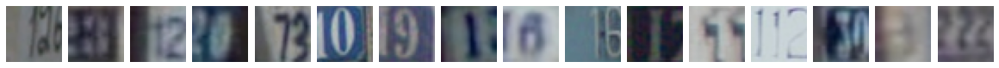

In [34]:


attack = fb.attacks.LinfDeepFoolAttack()
advs, clipped, is_adv = attack(fmodel, images, labels, epsilons=0.03)
fb.plot.images(images)

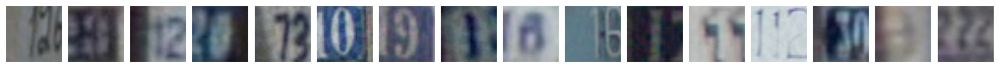

In [35]:
fb.plot.images(advs)